In [1]:
from pathlib import Path
import numpy as np
import matplotlib.pyplot as plt

from coremdlr.viz import CorePlotter
from coremdlr.datasets import WellLoader

from coremdlr.config.defaults import DEFAULT_TRAIN_PATH
from coremdlr.config.strip_config import lithologies_dict

Using TensorFlow backend.


In [2]:
def slice_data(image, log, labels, depths, top=None, base=None):
    pass
    

In [5]:
from coremdlr.datasets.utils import available_wells

labels = np.array(list(lithologies_dict.keys()), dtype='a2').tolist()
print(labels)

avail_wells = available_wells()
avail_wells

[b'nc', b'bs', b's', b'is', b'ih', b'os', b'sh']


{'204-19-3A',
 '204-19-6',
 '204-19-7',
 '204-20-1',
 '204-20-1Z',
 '204-20-2',
 '204-20-3',
 '204-20-6a',
 '204-20a-7',
 '204-24a-6',
 '204-24a-7',
 '205-21b-3'}

In [6]:
for wellname in avail_wells:
    well_labels = np.load(DEFAULT_TRAIN_PATH / (wellname+'_labels.npy'))
    well_labels = np.vectorize(lambda l: labels.index(l))(well_labels)
    print(wellname, np.round(np.bincount(well_labels) / well_labels.size, 2)[-2])

204-24a-6 0.0
204-20-1Z 0.0
205-21b-3 0.0
204-20-6a 0.09
204-20-2 0.0
204-19-7 0.04
204-24a-7 0.25
204-20-3 0.16
204-19-3A 0.31
204-20a-7 0.49
204-20-1 0.27
204-19-6 0.0


In [7]:
try_wells = [
    '204-20-1', # bad order
    '204-20a-7',
    '204-19-3A', # 
    '204-24a-7', # bad order
    '204-20-6a', # GOOD
    '204-20-3' # bad order
]

In [13]:
well_19_3a = WellLoader('204-19-3A', use_pseudoGR=True,
                  pseudoGR_args={'features': ['mean'], 'per_channel' : True})

well_19_3a.load_data(labels)

Loading Well:  204-19-3A  from  /home/administrator/Dropbox/core_data/facies/train_data


/home/administrator/code/python/coremdlr/coremdlr/datasets/utils.py:79: RuntimeWarning: Mean of empty slice
  output_features.append(np.nanmean(img, axis=1))


Extracted pGR features:  ['Umean', 'Rmean', 'Gmean', 'Bmean']
Feature shapes:  [('depth', (9590,)), ('top', (9590,)), ('base', (9590,)), ('image', (9590, 32, 600, 3)), ('pseudoGR', (9590, 32, 4))]


Could not determine order from tops and bases.
top: {'middle': 2214.2928343681824, 'units': 'm'}, base: {'middle': 2214.335794596409, 'units': 'm'}, order: depth
top: {'middle': 2214.335794596409, 'units': 'm'}, base: {'middle': 2214.7116965933883, 'units': 'm'}, order: depth
top: {'middle': 2214.7116965933883, 'units': 'm'}, base: {'middle': 2214.743916764558, 'units': 'm'}, order: depth
top: {'middle': 2214.743916764558, 'units': 'm'}, base: {'middle': 2214.905017620406, 'units': 'm'}, order: depth
top: {'middle': 2214.905017620406, 'units': 'm'}, base: {'middle': 2214.9372377915756, 'units': 'm'}, order: depth
top: {'middle': 2214.9372377915756, 'units': 'm'}, base: {'middle': 2215.082060748448, 'units': 'm'}, order: depth
top: {'middle': 2215.082060748448, 'units': 'm'}, base: {'middle': 2215.108910891089, 'units': 'm'}, order: depth
top: {'middle': 2215.108910891089, 'units': 'm'}, base: {'middle': 2215.1787212619565, 'units': 'm'}, order: depth
top: {'middle': 2215.1787212619565,

UnboundLocalError: local variable 'striplog' referenced before assignment

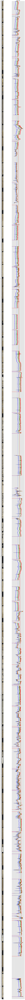

In [14]:
well = well_19_3a
coreplotter = CorePlotter(figsize=(17,600))

# plot image
coreplotter.plot_image(well._image / 255.0, well._depth) #, major_tick_size=18)
img_ax = coreplotter.get_ax_by_name('Image')
img_ax.set_title('Image', fontsize=24)

# plot RGB
r = well._pseudoGR[:, pGR_feat2idx['Rmean']]
g = well._pseudoGR[:, pGR_feat2idx['Gmean']]
b = well._pseudoGR[:, pGR_feat2idx['Bmean']]

xlim = np.nanmin(np.concatenate([r,g,b])), np.nanmax(np.concatenate([r,g,b]))
coreplotter.plot_log(well._depth, r, c='r', name='RGB', lw=3, alpha=0.9, xlim=xlim)
coreplotter.plot_log(well._depth, g, name='RGB', c='g', lw=3, alpha=0.7, xlim=xlim)
coreplotter.plot_log(well._depth, b, name='RGB', c='b', lw=3, alpha=0.5, xlim=xlim)

log_ax = coreplotter.get_ax_by_name('RGB')
log_ax.set_title('RGB Logs', fontsize=24)
log_ax.set_yticks([])
log_ax.set_xticklabels([])

# true labels
coreplotter.plot_strip(well.make_striplog(), name='Labels')
coreplotter.get_ax_by_name('Labels').set_title('Labels', fontsize=24)

coreplotter.fig.show()
#coreplotter.fig.savefig('pGR_labels_204-20-6a.png')

In [8]:
well_20_6a = WellLoader('204-20-6a', use_pseudoGR=True,
                  pseudoGR_args={'features': ['mean'], 'per_channel' : True})

well_20_6a.load_data(labels)

Loading Well:  204-20-6a  from  /home/administrator/Dropbox/core_data/facies/train_data


/home/administrator/code/python/coremdlr/coremdlr/datasets/utils.py:79: RuntimeWarning: Mean of empty slice
  output_features.append(np.nanmean(img, axis=1))


Extracted pGR features:  ['Umean', 'Rmean', 'Gmean', 'Bmean']
Feature shapes:  [('depth', (3542,)), ('top', (3542,)), ('base', (3542,)), ('image', (3542, 32, 600, 3)), ('pseudoGR', (3542, 32, 4))]


In [9]:
pGR_feat2idx = {feat_name : i for feat_name, i in zip(well_20_6a.pGR_feat_names, range(4))}
pGR_feat2idx

{'Umean': 0, 'Rmean': 1, 'Gmean': 2, 'Bmean': 3}

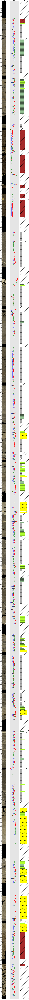

In [12]:
well = well_20_6a
coreplotter = CorePlotter(figsize=(17,600))

# plot image
coreplotter.plot_image(well._image / 255.0, well._depth, major_tick_size=18)
img_ax = coreplotter.get_ax_by_name('Image')
img_ax.set_title('Image', fontsize=24)

# plot RGB
r = well._pseudoGR[:, pGR_feat2idx['Rmean']]
g = well._pseudoGR[:, pGR_feat2idx['Gmean']]
b = well._pseudoGR[:, pGR_feat2idx['Bmean']]

xlim = np.nanmin(np.concatenate([r,g,b])), np.nanmax(np.concatenate([r,g,b]))
coreplotter.plot_log(well._depth, r, c='r', name='RGB', lw=3, alpha=0.9, xlim=xlim)
coreplotter.plot_log(well._depth, g, name='RGB', c='g', lw=3, alpha=0.7, xlim=xlim)
coreplotter.plot_log(well._depth, b, name='RGB', c='b', lw=3, alpha=0.5, xlim=xlim)

log_ax = coreplotter.get_ax_by_name('RGB')
log_ax.set_title('RGB Logs', fontsize=24)
log_ax.set_yticks([])
log_ax.set_xticklabels([])

# true labels
coreplotter.plot_strip(well.make_striplog(), name='Labels')
coreplotter.get_ax_by_name('Labels').set_title('Labels', fontsize=24)

#coreplotter.fig.show()
coreplotter.fig.savefig('pGR_labels_204-20-6a.png')

In [ ]:
well = well_20_3
coreplotter = CorePlotter(figsize=(15,600))

# plot image
coreplotter.plot_image(well._image / 255.0, well._depth)
img_ax = coreplotter.get_ax_by_name('Image')
img_ax.set_title('Image', fontsize=24)
img_ax.yaxis.set_minor_locator(plt.NullLocator())


# plot RGB
r = well._pseudoGR[:, pGR_feat2idx['Rmean']]
g = well._pseudoGR[:, pGR_feat2idx['Gmean']]
b = well._pseudoGR[:, pGR_feat2idx['Bmean']]

xlim = np.nanmin(np.concatenate([r,g,b])), np.nanmax(np.concatenate([r,g,b]))
coreplotter.plot_log(well._depth, r, c='r', name='RGB', lw=3, alpha=0.9, xlim=xlim)
coreplotter.plot_log(well._depth, g, name='RGB', c='g', lw=3, alpha=0.7, xlim=xlim)
coreplotter.plot_log(well._depth, b, name='RGB', c='b', lw=3, alpha=0.5, xlim=xlim)

log_ax = coreplotter.get_ax_by_name('RGB')
log_ax.set_title('RGB Logs', fontsize=24)
log_ax.set_yticks([])
log_ax.set_xticklabels([])

# true labels
coreplotter.plot_strip(well.make_striplog(), name='Labels')
coreplotter.get_ax_by_name('Labels').set_title('Labels', fontsize=24)

coreplotter.fig.show()

In [ ]:
for ax in coreplotter.ax:
    print(ax.get_ylim())

In [ ]:
well._y.shape, well._depth.shape, well._image.shape

In [10]:
np.repeat(True, well._depth.shape).all()

True

In [ ]:
['204-19-3A',
 '204-19-6',
 '204-19-7',
 '204-20-1',
 '204-20-1Z',
 '204-20-2',
 '204-20-3',
 '204-20-6a',
 '204-20a-7',
 '204-24a-6',
 '204-24a-7',
 '205-21b-3']